# Exercise 1

## Lemma1:
$\forall a, b \in \mathbb{R}^{+} \cup \{0\}, a \geq b \iff a^2 \geq b^2$

### Proof of Lemma1:
$\implies$
\begin{align*}
a & \geq b \\
a \cdot a \geq & b \cdot a \geq b \cdot b
\end{align*}
Thus, $a^2 \geq b^2$

$\impliedby$

If $b \ne 0$,
Prove by contradiction, we have $a^2 \geq b^2$, assume $a \lt b$.
Since $a, b \geq 0$, we have $a \cdot a \lt b\cdot a  \lt b \cdot b$, which introduced a contradiction.

On the other hand, if $b = 0$, then since $a \geq 0$, $a = 0$, thus $a \geq b \blacksquare$

Thus, we finished the proof

## Proof of Excercise 1

Given that we have proved $L^2$, defined as the space of square-integrable functions, equipped with the corresponding inner product, is a vector space, it follows that the inner product $\langle \cdot, \cdot \rangle$ satisfies:

$$
\langle f, g \rangle = \int_{\Omega} f(x) \overline{g(x)} \, dx
$$

for all $f, g \in L^2(\Omega)$, where $\Omega$ is the domain of definition and $\overline{g(x)}$ denotes the complex conjugate of $g(x)$, for $\mathbb{R}$, $\overline{g(x)} = g(x)$.

Thus, according to the definition of the inner product, and more generally, a metric, we have:

$$
\langle f, f \rangle \geq 0
$$

for all $f \in L^2(\Omega)$, which indicates that the inner product of any function with itself is always greater than or equal to zero.

Thus, to prove $d(f, f_n) \geq d(f, f_{n+1})$, by Lemma 1, it is equivalent to prove the inequality:

$$
d(f, f_n)^2 \geq d(f, f_{n+1})^2
$$


Let $g = f_{n + 1}$

We've proved that
\begin{align*}
d(f,g)^2 &= \langle f-g, f-g \rangle = \int (f-g)(\overline{f-g})
\\
&= \langle f, f \rangle + \langle g, g \rangle - 2\langle f, g \rangle
\\
&= \int f^2 + \int g^2 - 2 \int fg
\\
&= \|f\|^2 + \int (\sum_{i = 1}^{n} c_i e_i)(\overline{\sum_{j = 1}^{n} c_j e_j}) - 2\sum_{i = 1}^{n} c_i \langle f, e_i \rangle
\\
&= \|f\|^2 + \sum_{i = 1}^{n} c_i^2 - 2 \sum_{i = 1}^{n} c_i \langle f, e_i \rangle
\end{align*}

where $c_j = \langle f, e_j \rangle$. Thus, $d(f, f_{n+1})^2 = \|f\|^2 + \sum_{i=1}^{n+1} c_i^2 - 2\sum_{i=1}^{n+1} c_i \langle f, e_i \rangle = d(f, f_n)^2 + c_{n+1}^2 - 2c_{n+1}\langle f, e_{n+1} \rangle$, where the last part 

\begin{align*}
c_{n+1}^2 - 2c_{n+1}\langle f, e_{n+1} \rangle &= \langle f, e_{n+1} \rangle^2 - 2\langle f, e_{n+1} \rangle^2 \\
&= - \langle f, e_{n+1} \rangle^2 \\
&\leq 0 \\
\end{align*}
,thus proved $d(f, f_n)^2 \geq d(f, f_{n+1})^2$. By Lemma 1, since the metric defined by inner product is greater or equal to zero, we have proved $d(f, f_n) \geq d(f, f_{n+1})$.

# Excercise2

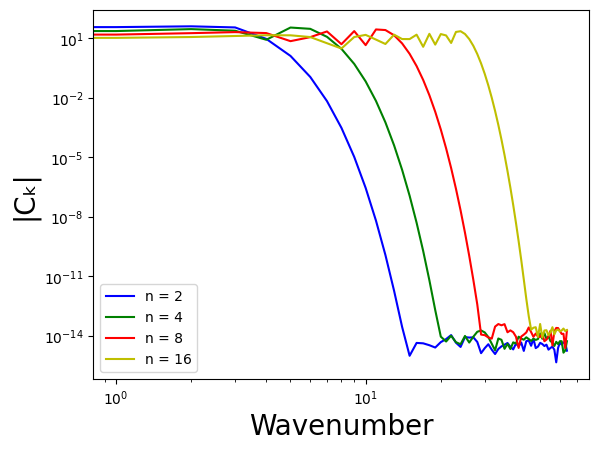

In [1]:
from pylab import *
import math

inf_p_deri_f = lambda theta, n: cos(n * sin(theta/2) * pi)

def dft(n):
    thetas = arange(0, 2*pi, 2*pi/128)
    f_values = [inf_p_deri_f(theta, n) for theta in thetas]
    dft = rfft(f_values)
    return dft

wavenumber = range(0, 65)
# wavenumber = range(0, 128)

dft_n_2 = dft(2)
dft_n_4 = dft(4)
dft_n_8 = dft(8)
dft_n_16 = dft(16)

modulus_n_2 = absolute(dft_n_2)
modulus_n_4 = absolute(dft_n_4)
modulus_n_8 = absolute(dft_n_8)
modulus_n_16 = absolute(dft_n_16)

plot(wavenumber, modulus_n_2, 'b-', 
     wavenumber, modulus_n_4, 'g-', 
     wavenumber, modulus_n_8, 'r-', 
     wavenumber, modulus_n_16, 'y-', )
xlabel("Wavenumber", fontsize=20)
ylabel("|C\u2096|", fontsize=20)
legend(["n = 2", "n = 4", "n = 8", "n = 16"],
        loc="lower left")
yscale('log')
xscale('log')

#### Better resolution version

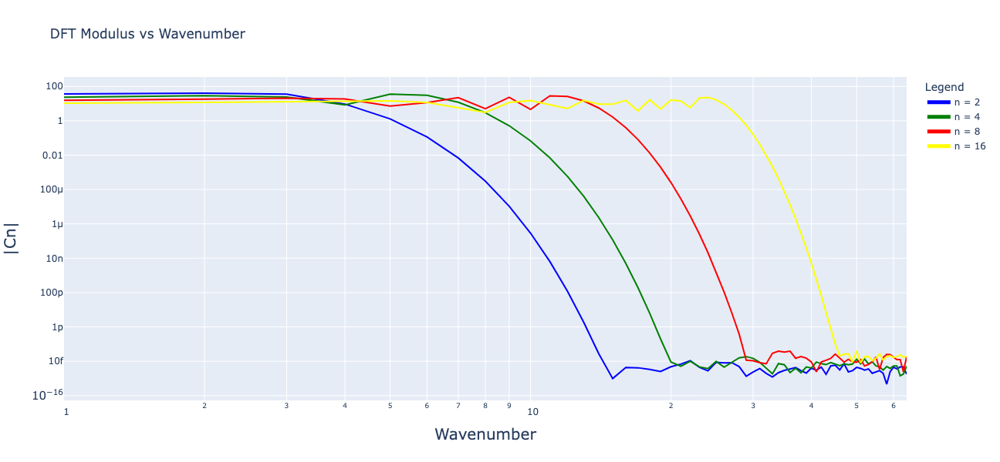

In [2]:
import plotly.graph_objects as go
import numpy as np

# Define the dft function
def dft(theta, n):
    f_values = np.cos(n * np.sin(theta / 2) * np.pi)
    dft = rfft(f_values)
    modulus = np.abs(dft)
    return modulus

# Generate theta and wavenumber
theta = np.arange(0, 2 * np.pi, 2 * np.pi / 128)
# wavenumber = np.fft.rfftfreq(128, 2 * np.pi / 128)
wavenumber = list(range(0, 65))
# Create traces for each n value
traces = []
n_values = [2, 4, 8, 16]
colors = ['blue', 'green', 'red', 'yellow']
for n, color in zip(n_values, colors):
    trace = go.Scatter(x=wavenumber, y=dft(theta, n), mode='lines', name=f'n = {n}', line=dict(color=color))
    traces.append(trace)

# Create the figure and update layout
fig = go.Figure(data=traces)
fig.update_layout(
    title='DFT Modulus vs Wavenumber',
    xaxis_title='Wavenumber',
    yaxis_title='|Cn|',
    xaxis_type='log',
    yaxis_type='log',
    xaxis=dict(titlefont=dict(size=20)),
    yaxis=dict(titlefont=dict(size=20)),
    legend=dict(title='Legend', itemsizing='constant'),
    width=800,
    height=600
)

# Show the figure
fig.show()


In [3]:
len(modulus_n_16)

65

In [4]:
modulus_n_2

array([2.81954443e+01, 3.68486870e+01, 4.04070998e+01, 3.55441159e+01,
       9.38180169e+00, 1.29772243e+00, 1.13070890e-01, 6.83823201e-03,
       3.05218340e-04, 1.04939818e-05, 2.86900104e-07, 6.39254453e-09,
       1.18390847e-10, 1.85090350e-12, 2.78565342e-14, 9.82836620e-16,
       4.37244394e-15, 4.16729171e-15, 3.34591022e-15, 2.55444565e-15,
       4.79747557e-15, 6.81830523e-15, 1.08347752e-14, 4.47274214e-15,
       2.74290167e-15, 8.61106897e-15, 8.13238095e-15, 8.35279207e-15,
       4.89820817e-15, 1.32899742e-15, 2.38105646e-15, 3.75985035e-15,
       1.98602732e-15, 1.20403124e-15, 2.16328171e-15, 2.93045478e-15,
       3.55705088e-15, 4.32034197e-15, 2.81500046e-15, 2.05959260e-15,
       4.02305951e-15, 2.97655733e-15, 4.55603185e-15, 1.72896574e-15,
       5.34493553e-15, 5.85016270e-15, 3.13757278e-15, 7.11556975e-15,
       2.39391990e-15, 2.83977684e-15, 4.40423080e-15, 3.84370056e-15,
       3.04394388e-15, 3.56579899e-15, 2.00378954e-15, 2.43296885e-15,
      

In [5]:
wavenumber[:10]

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]

In [6]:
dft_n_2

array([ 2.81954443e+01+0.00000000e+00j, -3.68486870e+01+5.66213743e-15j,
        4.04070998e+01-1.23011590e-14j,  3.55441159e+01-1.57651669e-14j,
        9.38180169e+00-2.27595720e-15j,  1.29772243e+00-4.38191150e-15j,
        1.13070890e-01-3.54037173e-15j,  6.83823201e-03+2.67792516e-15j,
        3.05218340e-04+7.15714042e-16j,  1.04939818e-05-1.02295491e-15j,
        2.86900104e-07+2.54805814e-15j,  6.39254453e-09+1.63660725e-15j,
        1.18390847e-10+1.23641649e-15j,  1.85090345e-12-4.58869618e-16j,
        2.78556185e-14+2.25865830e-16j,  6.18512498e-16+7.63812878e-16j,
       -4.05067994e-15-1.64628612e-15j, -3.02644833e-15-2.86477411e-15j,
        3.31657570e-15-4.42086878e-16j,  2.18804739e-15-1.31819619e-15j,
        4.68953051e-17-4.79724636e-15j,  6.04415902e-15-3.15553925e-15j,
        9.83570743e-15+4.54436069e-15j, -1.64166778e-17+4.47271201e-15j,
       -1.65923114e-15+2.18413864e-15j,  5.52311115e-15+6.60649317e-15j,
       -2.75906301e-15+7.65004518e-15j, -8.34483111

In [7]:
len(wavenumber)

65

## Trying to find the trig interpolation function from the coefficient calculated
From the textbook, we have the following Theroem
![Alternative_text](DFT_Int_Theorem.png)

### Yet I met a problem while finding the intepolation function
1. y points calculated by `rfft` is $\frac{n}{2} + 1$ with $n$ intepolation points, this is due to the symmetry while intepolation a real function
2. Even with the classic `fft`, the coeficient is not the same with the one provided by the textbook.

I tried to come up with a function that takes into $\frac{n}{2} + 1$ complex coefficients, but I did not get a good one.
Thus, for simplicity, I will use `fft` for finding the intepolation function for now

### New defined dft

In [8]:
def dft(n):
    thetas = arange(0, 2*pi, 2*pi/128)
    f_values = [inf_p_deri_f(theta, n) for theta in thetas]
    dft = fft(f_values)
    return dft

wavenumber = range(0, 65)
# wavenumber = range(0, 128)

dft_n_2 = dft(2)
dft_n_4 = dft(4)
dft_n_8 = dft(8)
dft_n_16 = dft(16)

The following are the original function I tried to come up with the intepolation function. Yet due to the optimization, even with the correct number of points intepolation, the intepolation function's coefs is still different from the one provided by the textbook

In [9]:
import numpy as np

def P(t, a_coefficients, b_coefficients, c, d, n):
    summation = 0
    for k in range(n):
        ak = a_coefficients[k]  # k-th coefficient for cosine terms
        bk = b_coefficients[k]  # k-th coefficient for sine terms
        summation += ak * np.cos(2 * np.pi * k * ((t - c) / (d - c))) - bk * np.sin(2 * np.pi * k * ((t - c) / (d - c)))
    return (1 / np.sqrt(n)) * summation

def get_trig_inter_func(dft, c, d):
    a_coefficients = [i.real for i in dft]
    b_coefficients = [i.imag for i in dft]
    n = len(dft)
    def trig_inter_func(t):
        return P(t, a_coefficients, b_coefficients, c, d, n)
    return trig_inter_func

# def P(t, a_coefficients, b_coefficients, c, d, n):
#     summation = a_coefficients[0]  # The zero-frequency term has no sine component and should be added only once.
#     for k in range(1, n // 2):  # Loop through the positive frequencies.
#         # Calculate the cosine and sine terms
#         cosine_term = np.cos(2 * np.pi * k * (t - c) / (d - c))
#         sine_term = np.sin(2 * np.pi * k * (t - c) / (d - c))
#         summation += a_coefficients[k] * cosine_term
#         summation += b_coefficients[k] * sine_term
#     summation += a_coefficients[-1] * np.cos(np.pi * (t - c) / (d - c))  # Nyquist frequency term
#     return (1 / np.sqrt(n)) * summation

# def get_trig_inter_func(dft, c, d, n):
#     # Handle the symmetric part of the DFT coefficients for a real-valued signal.
#     a_coefficients = [dft[0].real] + [coeff.real for coeff in dft[1:n//2]] + [dft[n//2].real]
#     b_coefficients = [0] + [coeff.imag for coeff in dft[1:n//2]] + [0]  # Imaginary part for Nyquist frequency is 0.
#     def trig_inter_func(t):
#         return P(t, a_coefficients, b_coefficients, c, d, n)
#     return trig_inter_func

### Correct function
I did some research and find the following optimazation used for `fft`, mainly from `numpy`'s documentation.
1. Normalization: After applying the FFT, the resulting coefficients should be scaled properly. The typical convention is that the coefficients of the FFT need to be divided by the number of samples when you want to use them for further calculations, such as an inverse FFT or in this case, trigonometric interpolation.
2. Symmetry: For a real-valued function, the Fourier coefficients will be symmetric. Only half of the FFT output is unique when the input signal is purely real; the second half is just the complex conjugate of the first half.
3. Nyquist Frequency: If the number of samples $(N)$ is even, the term at $N/2$ (the Nyquist frequency) should only be counted once.

Thus, we need to do the following:
- We'll scale the a coefficients (real part) by $2/N$ for all but the first and possibly the Nyquist term (which should be scaled by $1/N$).
- The b coefficients (imaginary part) need to be scaled similarly, but also need a sign change because in the standard DFT formula, the sine terms are subtracted, not added.

The following is the corrected function

In mathmatic form:
Let $n$ be the total number of Discrete Fourier Transform (DFT) results or a given $t_{\text{num}}$ if provided. For a complex number $z$, $\Re(z)$ represents the real part, and $\Im(z)$ represents the imaginary part.

The coefficients are defined as:

- $x_0 = \frac{\Re(\text{dft\_results}[0])}{n}$
- For $k = 1, 2, \ldots, \left\lfloor \frac{n}{2} \right\rfloor - 1$:
  - $a_k = \frac{2 \cdot \Re(\text{dft_results}[k])}{n}$
  - $b_k = -\frac{2 \cdot \Im(\text{dft_results}[k])}{n}$

If $n$ is even, then:

- $a_{\frac{n}{2}} = \frac{\Re(\text{dft_results}[\frac{n}{2}])}{n}$

If $n$ is odd, the last term is included in the series and is doubled:

- $a_{\frac{n}{2}} = \frac{2 \cdot \Re(\text{dft_results}[\frac{n}{2}])}{n}$

The trigonometric interpolation function $f(t)$ at a point $t$ is given by:

- $f(t) = a_0 + \sum_{k=1}^{\left\lfloor \frac{n}{2} \right\rfloor - 1} \left( a_k \cdot \cos\left(\frac{2 \pi k t}{d - c}\right) + b_k \cdot \sin\left(\frac{2 \pi k t}{d - c}\right) \right)$

If $n$ is even, include the Nyquist term:

- $f(t) += a_{\frac{n}{2}} \cdot \cos\left(\frac{\pi n t}{2(d - c)}\right)$

In [10]:
def get_trig_interpolation_function(dft_results, c, d, t_num: int = None):
    if t_num is None:
        n = len(dft_results)
    else:
        n = t_num
    a0 = dft_results[0].real / n  # The constant term (DC component) should not be doubled
    an = (dft_results[1:n // 2].real * 2 / n).tolist()  # The cosine coefficients
    bn = (-dft_results[1:n // 2].imag * 2 / n).tolist()  # The sine coefficients

    # If n is even, the Nyquist frequency term should be handled separately and should not be doubled
    if n % 2 == 0:
        an.append(dft_results[n // 2].real / n)
    else:  # If n is odd, the last term is still a part of the series and should be doubled
        an.append(dft_results[n // 2].real * 2 / n)

    # Function to calculate the trigonometric interpolation at a given point t
    def trig_interpolation_function(t):
        result = a0
        for k in range(1, n // 2):
            result += an[k - 1] * np.cos(2 * np.pi * k * t / (d - c))
            result += bn[k - 1] * np.sin(2 * np.pi * k * t / (d - c))
        if n % 2 == 0:  # Add the Nyquist term
            result += an[-1] * np.cos(np.pi * (n // 2) * t / (d - c))
        return result

    return trig_interpolation_function

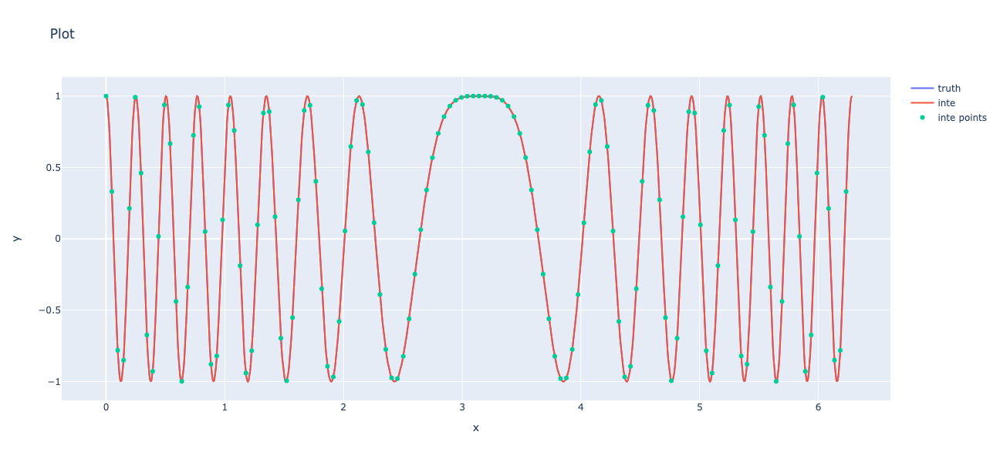

In [11]:
x = np.linspace(0, 2 * np.pi, 1000)
thetas = arange(0, 2*np.pi, 2*np.pi/128)
fig = go.Figure()

y = [inf_p_deri_f(i, 16) for i in x]
trig_inte_f = get_trig_interpolation_function(dft_n_16, 0, 2*pi, 128)
s = [trig_inte_f(i) for i in x]

inte_ps = [inf_p_deri_f(i, 16) for i in thetas]

# Add a scatter plot to the figure
fig.add_trace(go.Scatter(x=x, y=y, mode='lines', name='truth'))
fig.add_trace(go.Scatter(x=x, y=s, mode='lines', name='inte'))
fig.add_trace(go.Scatter(x=thetas, y=inte_ps, mode='markers', name='inte points'))

# Update layout for a better view
fig.update_layout(
    title='Plot',
    xaxis_title='x',
    yaxis_title='y',
    autosize=False,
    width=800,
    height=600
)

# Show the plot
fig.show()

### Draw a graph based on how many terms used for summation

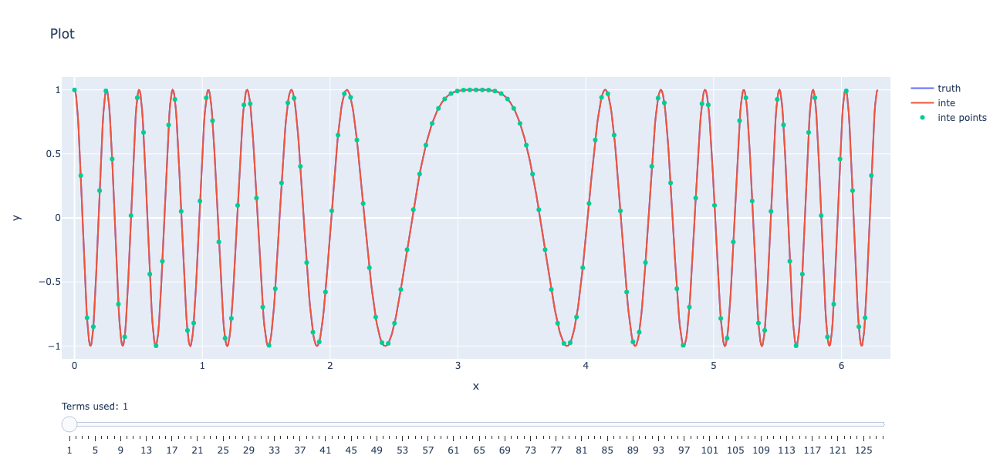

In [12]:
x = np.linspace(0, 2 * np.pi, 1000)
thetas = arange(0, 2*np.pi, 2*np.pi/128)
fig = go.Figure()

y = [inf_p_deri_f(i, 16) for i in x]
trig_inte_f = get_trig_interpolation_function(dft_n_16, 0, 2*pi, 128)
s = [trig_inte_f(i) for i in x]

inte_ps = [inf_p_deri_f(i, 16) for i in thetas]

# Add a scatter plot to the figure
fig.add_trace(go.Scatter(x=x, y=y, mode='lines', name='truth'))
fig.add_trace(go.Scatter(x=x, y=s, mode='lines', name='inte'))
fig.add_trace(go.Scatter(x=thetas, y=inte_ps, mode='markers', name='inte points'))

sliders = []

slider_a = dict(
    active=0,
    currentvalue={"prefix": "Terms used: "},
    pad={"t": 50},
    steps=[{
        'method': 'restyle',  # Using 'restyle' to update existing traces
        'label': str(a),
        'args': [{
            'y': [
                y,  # Reapply existing data for 'truth' trace
                list(get_trig_interpolation_function(dft_n_16, 0, 2*pi, a)(i) for i in x),  # Update data for 'inte' trace
                inte_ps  # Reapply existing data for 'inte points' trace
            ]
        },
        [0, 1, 2]  # Indices of the traces to update: 0 for 'truth', 1 for 'inte', 2 for 'inte points'
        ]
    } for a in range(1, 129)]
)
sliders.append(slider_a)

# Update layout for a better view
fig.update_layout(
    sliders=sliders,
    title='Plot',
    xaxis_title='x',
    yaxis_title='y',
    autosize=False,
    width=800,
    height=600,
    xaxis=dict(range=[0  - 0.1, 2*pi + 0.1]),  # Set fixed range for x-axis
    yaxis=dict(range=[-1 - 0.1, 1    + 0.1])
)



# Show the plot
fig.show()

Assume the "wavenumber" refers to the frequency domain representation of a given function. Specifically, it is related to the spatial frequency of a wave, which corresponds to the number of wave cycles per unit distance.

Assume the "modulus of the Discrete Fourier Transform of $f$" refers to the magnitude of the complex numbers that result from applying the DFT to $f$

Let's take a closer look at the equation in the thereom:
- $a_k$ and $b_k$ are the Fourier coefficients that correspond to the amplitude of each cosine and sine component, respectively.
- $t$ is the independent variable, which could represent time or space.
- $c$ and $d$ define the interval over which the function is defined or observed, with $t$ ranging from $c$ to $d$.
- The term $\frac{2\pi k(t - c)}{d - c}$ scales the wavenumber $k$ across the interval $[c, d]$.
- The wavenumber $k$ corresponds to the frequency of the sine and cosine functions; it is the index of the sum and represents how many cycles of the wave are completed in the interval from $c$ to $d$.

## Explanation for Excercise2
The graphs shown ($C_k$ and $k$) illustrate two primary relationships: the magnitude of the Fourier coefficients $C_k$ as a function of the wavenumber $k$, and the critical wavenumber $k_{cut}$ as a function of the parameter $n$.

### Relationship between $C_k$ and $k$:

In the context of Fourier Transformation, the Fourier coefficients $C_k$ can be seen as coordinates in a higher-dimensional space, where each dimension corresponds to a sine or cosine basis function.

As $k$ increases, we are effectively examining higher frequency components of the original function. If the coefficients $C_k$ decay with increasing $k$, it suggests that high-frequency components have less influence on the shape of the original function — in other words, the function is smoother and contains fewer rapid oscillations.

This is akin to a weighted sum of the basis functions, where the weight is given by the magnitude of $C_k$. For lower values of $k$, the weights are larger, signifying that these frequencies are more significant in reconstructing the original function. As $k$ increases (and the corresponding frequencies become higher), the weights $|C_k|$ decrease, indicating these high-frequency basis functions contribute less to the original function. This behavior is characteristic of a function that is more regular or smooth because it lacks high-frequency components.

### Relationship between $k_{cut}$ and $n$:

The critical wavenumber $k_{cut}$ can be viewed as a turning point beyond which the magnitude of the Fourier coefficients decreases rapidly. The position of $k_{cut}$ is intrinsically linked to the parameter $n$ of the function $f(\theta) = \cos(n \sin(\theta/2) \pi)$. As $n$ increases, the function $f(\theta)$ incorporates more oscillations within the fixed interval $[0, 2\pi]$, and therefore, its Fourier transform will have significant coefficients up to a higher wavenumber. This shifts $k_{cut}$ to a larger value, implying that the function contains substantial frequency components up to this new $k_{cut}$. It is this shift that reflects the increase in $n$ and thus the increase in the number of oscillations in $f(\theta)$.

In summary, the magnitude of the Fourier coefficients $C_k$ represents the contribution of each frequency component to the original function, and a rapid decay in $|C_k|$ with respect to $k$ indicates a predominance of lower frequencies in the function's composition. Meanwhile, the dependency of $k_{cut}$ on $n$ demonstrates that more complex functions with more rapid oscillations (higher $n$) will naturally have a broader spectrum of significant frequency components before this decay commences.

# Excercise3

The derivative $f'(t)$ is:

\begin{align*}
f'(t) = -\sum_{k=1}^{\left\lfloor \frac{n}{2} \right\rfloor - 1} \left( a_k \cdot \frac{2 \pi k}{d - c} \cdot \sin\left(\frac{2 \pi k t}{d - c}\right) - b_k \cdot \frac{2 \pi k}{d - c} \cdot \cos\left(\frac{2 \pi k t}{d - c}\right) \right)
\end{align*}

Here's the breakdown:

- The $a_0$ term disappears as its derivative is zero (being a constant term).
- The derivative of $a_k \cdot \cos\left(\frac{2 \pi k t}{d - c}\right)$ is $-a_k \cdot \frac{2 \pi k}{d - c} \cdot \sin\left(\frac{2 \pi k t}{d - c}\right)$ due to the chain rule.
- The derivative of $b_k \cdot \sin\left(\frac{2 \pi k t}{d - c}\right)$ is $b_k \cdot \frac{2 \pi k}{d - c} \cdot \cos\left(\frac{2 \pi k t}{d - c}\right)$, also by the chain rule.

This derivative captures the rate of change of the trigonometric interpolation function with respect to time $t$.

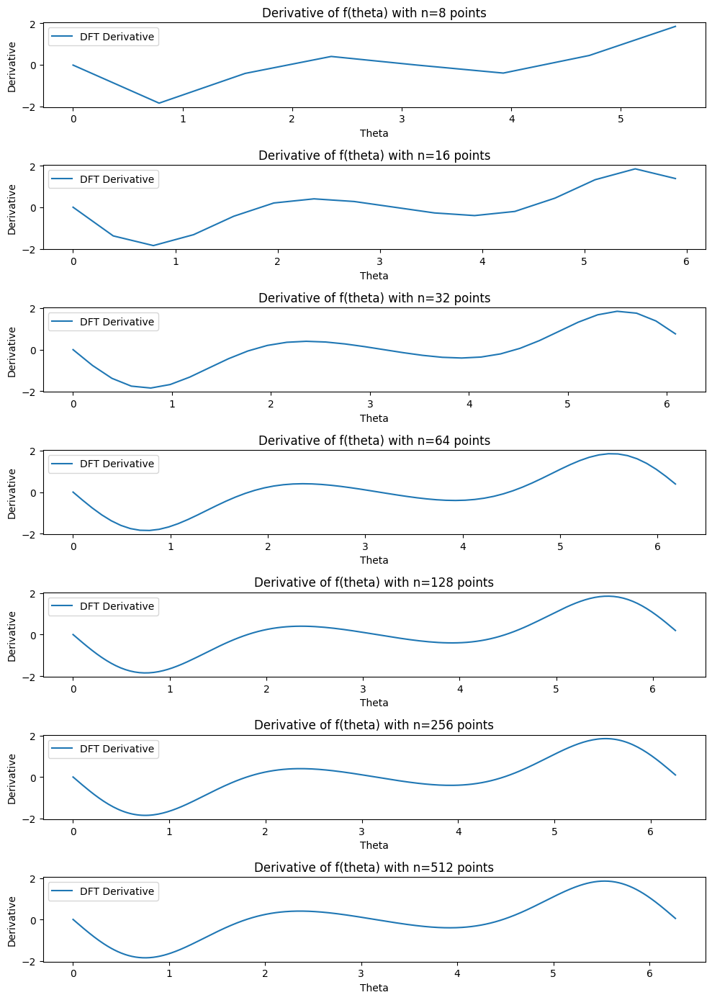

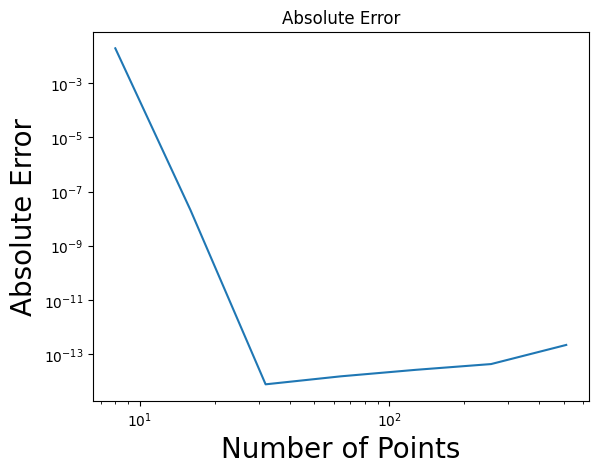

In [13]:
from pylab import *
import math

def get_trig_interpolation_di(dft_results, c, d, t_num=None):
    if t_num is None:
        n = len(dft_results)
    else:
        n = t_num
    a0 = dft_results[0].real / n  # The constant term (DC component)
    an = (dft_results[1:n // 2].real * 2 / n).tolist()  # The cosine coefficients
    bn = (-dft_results[1:n // 2].imag * 2 / n).tolist()  # The sine coefficients

    # Handling the Nyquist frequency term
    if n % 2 == 0:
        an.append(dft_results[n // 2].real / n)
    else:
        an.append(dft_results[n // 2].real * 2 / n)

    # Function to calculate the trigonometric interpolation at a given point t
    def trig_interpolation_function_d(t):
        result = 0
        for k in range(1, n // 2):
            result += -an[k - 1] * np.sin(2 * np.pi * k * t / (d - c)) * (2 * np.pi * k / (d - c))
            result += bn[k - 1] * np.cos(2 * np.pi * k * t / (d - c)) * (2 * np.pi * k / (d - c))
        if n % 2 == 0:
            result += -an[-1] * np.cos(np.pi * (n // 2) * t / (d - c)) * (np.pi * (n // 2) / (d - c))
        return result

    return trig_interpolation_function_d

def calc_f_d(f_values, c, d, theta):
    dft_result = np.fft.rfft(f_values)
    trig_interpolation = get_trig_interpolation_di(dft_result, c, d, len(f_values))
    derivative_values = [trig_interpolation(theta_i) for theta_i in theta]
    return derivative_values

def f(theta):
    return cos(4 * sin(theta/2))

def f_p(theta):
    return -2 * sin(4 * sin(theta/2)) * cos(theta/2)

interval = [2**n for n in range(3,10)]
absolute_errors = []

# ---- another version of visualization ---

# for n in interval:
#     theta = arange(0, 2*pi,2*pi/n)
#     d_theta = 2*pi/n
#     f_values = f(theta)
#     fp_values = f_p(theta)
#     derivative = calc_f_d(f_values, 0, 2 * np.pi, theta)
#     max_error = max(abs(fp_values - derivative))
#     absolute_errors.append(max_error)

    
#     figure()
#     plot(theta, derivative, label='DFT Derivative')
#     title(f'Derivative of f(theta) with n={n} points')
#     xlabel('Theta')
#     ylabel('Derivative')
#     legend()
#     show()


import matplotlib.pyplot as plt

# Assuming 'interval' is a list of values for 'n'
rows = len(interval)  # One row for each plot
fig, axes = plt.subplots(rows, 1, figsize=(10, 2*rows))  # Adjust figsize to make plots wider and shorter

for idx, n in enumerate(interval):
    theta = np.arange(0, 2*np.pi, 2*np.pi/n)
    d_theta = 2*np.pi/n
    f_values = f(theta)  # Make sure 'f' is defined
    fp_values = f_p(theta)  # Make sure 'f_p' is defined
    derivative = calc_f_d(f_values, 0, 2 * np.pi, theta)  # Make sure 'calc_f_d' is defined
    max_error = max(abs(fp_values - derivative))
    absolute_errors.append(max_error)  # Make sure 'absolute_errors' is initialized

    ax = axes[idx] if rows > 1 else axes  # If only one plot, axes is not a list
    ax.plot(theta, derivative, label='DFT Derivative')
    ax.set_title(f'Derivative of f(theta) with n={n} points')
    ax.set_xlabel('Theta')
    ax.set_ylabel('Derivative')
    ax.legend()

plt.tight_layout()  # Adjust subplots to fit in the figure area
plt.show()

plot(interval, absolute_errors)
xlabel("Number of Points", fontsize=20)
ylabel("Absolute Error", fontsize=20)
title("Absolute Error")

yscale('log')   
xscale('log')

#### Second Approach

Other than calculating the derivative of intepolating function, I found another approach also give the safe effect:

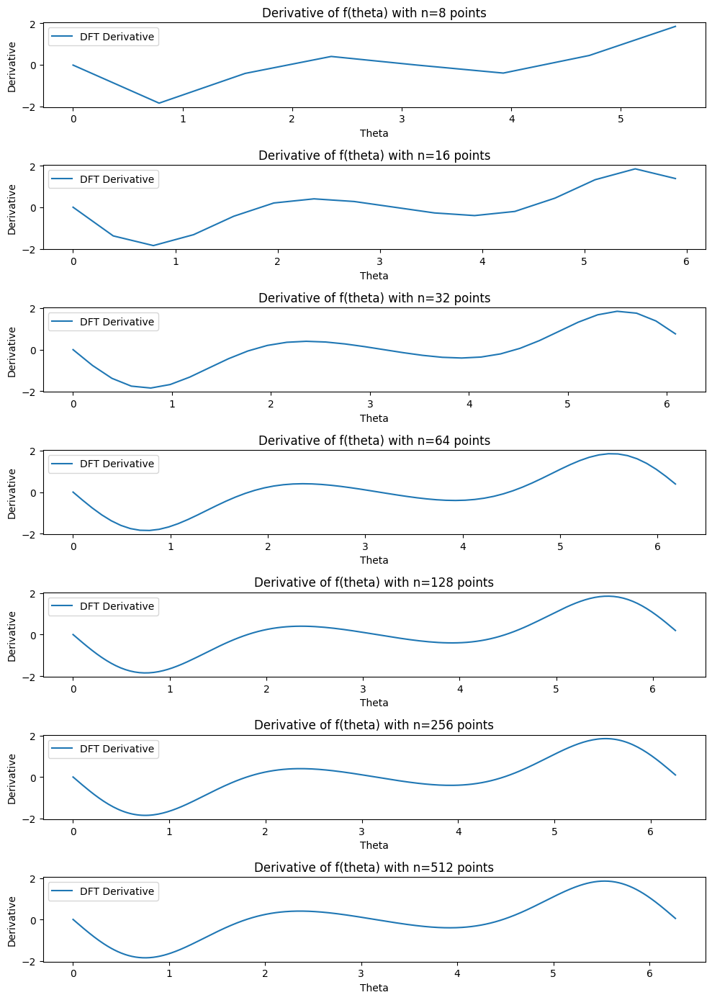

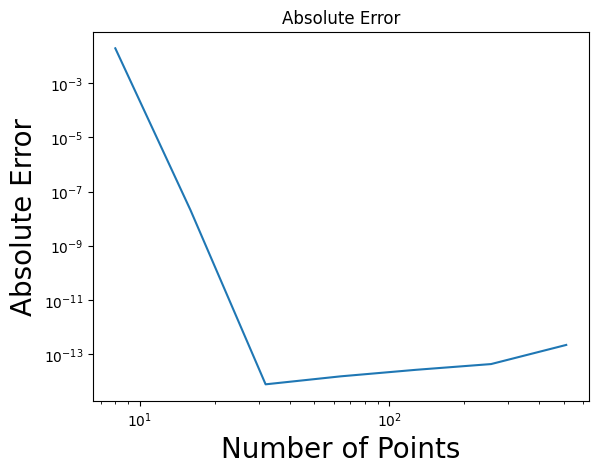

In [14]:
from pylab import *
import math

def f(theta):
    return cos(4 * sin(theta/2))

def f_p(theta):
    return -2 * sin(4 * sin(theta/2)) * cos(theta/2)

def dftDerivative(f_values,d_theta):
    dft = rfft(f_values)
    k = rfftfreq(len(f_values), d_theta)
    dft_derivative = dft * (1j * 2 * pi * k)
    derivative = irfft(dft_derivative, len(f_values))
    return derivative

interval = [2**n for n in range(3,10)]
absolute_errors = []
import matplotlib.pyplot as plt

# Assuming 'interval' is a list of values for 'n'
rows = len(interval)  # One row for each plot
fig, axes = plt.subplots(rows, 1, figsize=(10, 2*rows))  # Adjust figsize to make plots wider and shorter

for idx, n in enumerate(interval):
    theta = np.arange(0, 2*np.pi, 2*np.pi/n)
    d_theta = 2*np.pi/n
    f_values = f(theta)  # Make sure 'f' is defined
    fp_values = f_p(theta)  # Make sure 'f_p' is defined
    derivative = calc_f_d(f_values, 0, 2 * np.pi, theta)  # Make sure 'calc_f_d' is defined
    max_error = max(abs(fp_values - derivative))
    absolute_errors.append(max_error)  # Make sure 'absolute_errors' is initialized

    ax = axes[idx] if rows > 1 else axes  # If only one plot, axes is not a list
    ax.plot(theta, derivative, label='DFT Derivative')
    ax.set_title(f'Derivative of f(theta) with n={n} points')
    ax.set_xlabel('Theta')
    ax.set_ylabel('Derivative')
    ax.legend()

plt.tight_layout()  # Adjust subplots to fit in the figure area
plt.show()

plot(interval, absolute_errors)
xlabel("Number of Points", fontsize=20)
ylabel("Absolute Error", fontsize=20)
title("Absolute Error")

yscale('log')   
xscale('log')

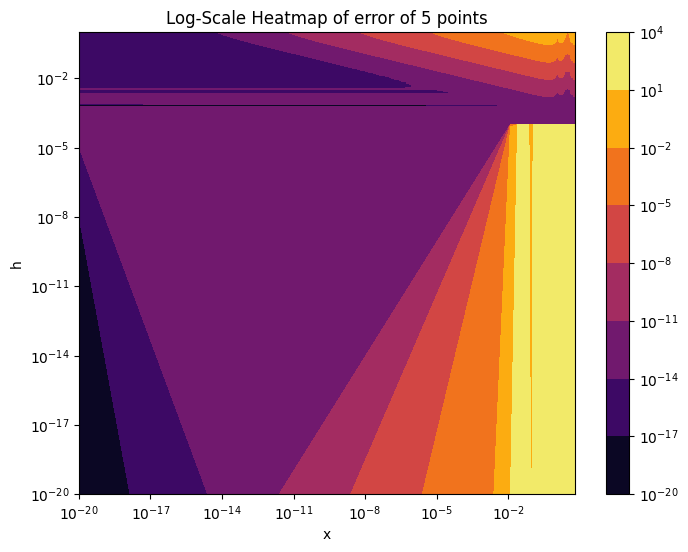

In [15]:
from pylab import *
import math
import numpy as np
import matplotlib.pyplot as plt

# Define the function
def error(x, h):
    correct = f_p(x)
    approx = calc_diff_5p(g, x, h)
    return abs(correct - approx)
    
def calc_diff_3p(f, x, h):
    return (f(x + h) - f(x - h)) / (2 * h)

def calc_diff_5p(f, x, h):
    return (f(x - 2*h) - 8 * f(x - h) + 8 * f(x + h) - f(x + 2 * h)) / (12 * h)

def g(theta):
    return cos(4 * sin(theta/2))

def f_p(theta):
    return -2 * sin(4 * sin(theta/2)) * cos(theta/2)

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm

# Define the function
def f(x, y):
    return x**2 + y**2 + 1  # Adding 1 to avoid log(0)

# Create a meshgrid of x and y values
x = np.linspace(1e-20, 2*pi, 512)  # Start from 0.1 to avoid log(0)
y = np.linspace(1e-20, 1, 10000)
X, Y = np.meshgrid(x, y)

# Evaluate the function at each point
Z = error(X, Y)

# Create the heatmap with logarithmic scale for Z values
plt.figure(figsize=(8, 6))
heatmap = plt.contourf(X, Y, Z, 50, cmap='inferno', norm=LogNorm())
plt.colorbar(heatmap)
plt.xlabel('x')
plt.ylabel('h')
plt.title('Log-Scale Heatmap of error of 5 points')

# Set both axes to logarithmic scale
plt.gca().set_xscale('log')
plt.gca().set_yscale('log')

plt.show()

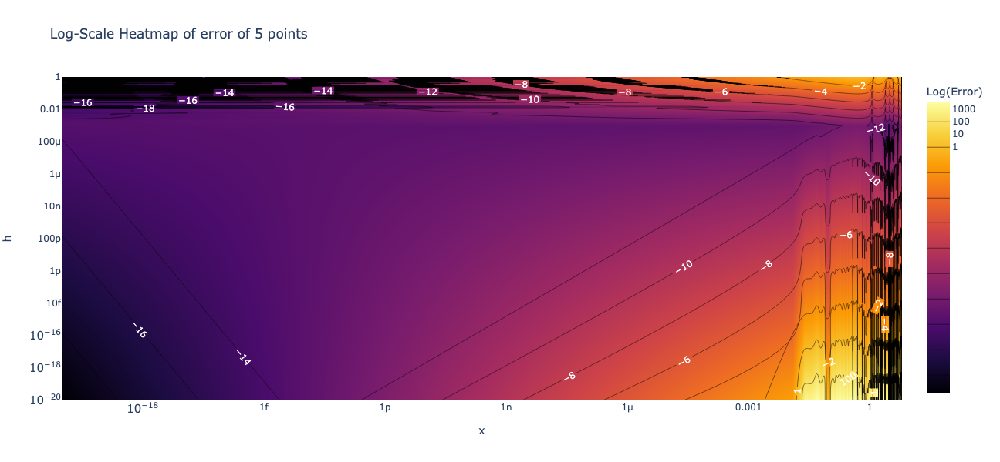

In [20]:
import plotly.graph_objects as go
import numpy as np

Z_log = np.where(Z > 0, np.log10(Z), 0)

# Assuming the error, calc_diff_5p, and g functions are defined as above

# Create the meshgrid of x and y values
x = np.linspace(1e-20, 2*np.pi, 512)
y = np.linspace(1e-20, 1, 1000)
X, Y = np.meshgrid(x, y)

# Compute Z values using your error function
Z = error(X, Y)

# Create the contour plot
fig = go.Figure(data=
    go.Contour(
        z=Z_log,  # Use the log-transformed Z values
        x=X[0],  # x coordinates
        y=Y[:, 0],  # y coordinates
        colorscale='Inferno',
        colorbar=dict(
            title='Log(Error)',  # Update the colorbar title to reflect the log scale
            tickvals=[0, 1, 2, 3],  # Example tick values
            ticktext=['1', '10', '100', '1000']  # Corresponding tick labels
        ),
        contours=dict(
            coloring='heatmap',
            showlabels=True,
            labelfont=dict(
                size=12,
                color='white',
            ),
        )
    )
)

# Update layout with log scale and titles
fig.update_layout(
    title='Log-Scale Heatmap of error of 5 points',
    xaxis_title='x',
    yaxis_title='h',
    xaxis_type='log',
    yaxis_type='log',
    width=800,
    height=600
)

fig.show()


## Estimate the correct decimal digits
We know:
- $\text{Number of correct decimal digits} \approx -\log_{10}(\text{error})$

We can consider the truncation error associated with each method.

The truncation error in a finite difference method is associated with the step size ($h$) and the order of the method. For a second-order method, the truncation error scales with $h^2$, and for a fourth-order method, it scales with $h^4$. (We consider the best case here since we want to see the best possible accuracy.)

For example, with a second-order finite-differences method, if we were to halve the step size $h$, the error would be reduced by a factor of $4$ ($(1/2)^2 = 1/4$). The convergence rate gives us an indication of the improvement in the number of correct decimal digits when the step size is refined.

To estimate the number of correct decimal digits for each method, we get:

For the highest resolution (using 512 points over the interval $[0, 2\pi]$), the step size $h$ would be:

$h = \frac{2\pi}{512}$

For a second-order method, the error term would scale as $h^2$, and for a fourth-order method, as $h^4$. So we would calculate the error terms as:

- $\text{Error}_{\text{2nd-order}} \propto \left(\frac{2\pi}{512}\right)^2$
- $\text{Error}_{\text{4th-order}} \propto \left(\frac{2\pi}{512}\right)^4$

Then, taking the logarithm base 10 of each error estimate will approximate the number of correct decimal places one might expect for each method.

In [17]:
import numpy as np

# Function to estimate the number of correct decimal digits for a given error
def estimate_decimal_digits(error):
    return -np.log10(error)

# Given values
points = 512  # highest resolution
interval = (0, 2 * np.pi)

# Step size calculation
h = (interval[1] - interval[0]) / points

# Error estimation for second-order and fourth-order methods
error_2nd_order = h**2
error_4th_order = h**4

# Estimation of correct decimal digits
decimal_digits_2nd_order = estimate_decimal_digits(error_2nd_order)
decimal_digits_4th_order = estimate_decimal_digits(error_4th_order)

(decimal_digits_2nd_order, decimal_digits_4th_order)


(3.8221801852354313, 7.644360370470863)

We take floor on both, thus get the result of 3 digit and 7 digit

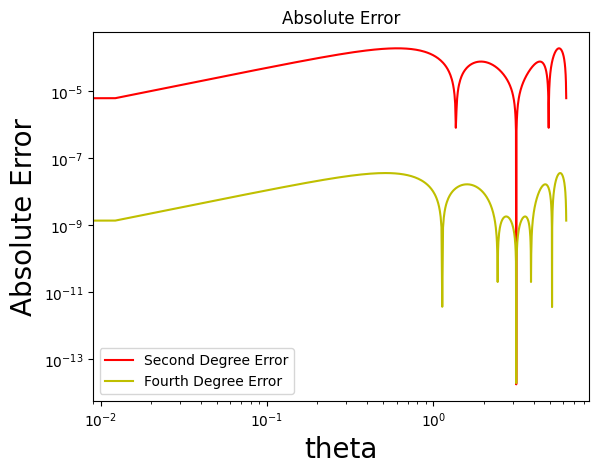

Max Error 3p:0.00018922344983240968
Max Error 5p:3.595865138983356e-08


In [18]:
from pylab import *
import math

def f(theta):
    return cos(4 * sin(theta/2))

def f_p(theta):
    return -2 * sin(4 * sin(theta/2)) * cos(theta/2)

interval = [2**n for n in range(3,10)]
absolute_errors = []
for n in interval:
    theta = arange(0, 2*pi,2*pi/n)
    d_theta = 2*pi/n
    f_values = f(theta)
    fp_values = f_p(theta)
    derivative = calc_f_d(f_values, 0, 2 * np.pi, theta)
    max_error = max(fabs(fp_values - derivative))
    absolute_errors.append(max_error)
    if(n == 512):
        finite_d2d = calc_diff_3p(f,theta, h = 2*pi/512)
        finite_d4d = calc_diff_5p(f,theta, h = 2*pi/512)
        error2d = fabs(derivative-finite_d2d)
        error4d = fabs(derivative-finite_d4d)



plot(theta, error2d, label='Second Degree Error', color='r')
plot(theta, error4d, label='Fourth Degree Error', color='y')
xlabel("theta", fontsize=20)
ylabel("Absolute Error", fontsize=20)
title("Absolute Error")
yscale('log')   
xscale('log')
legend()
show()

print(f'Max Error 3p:{max(error2d)}') 
print(f'Max Error 5p:{max(error4d)}')


This result verified our proof

# Excercise 4

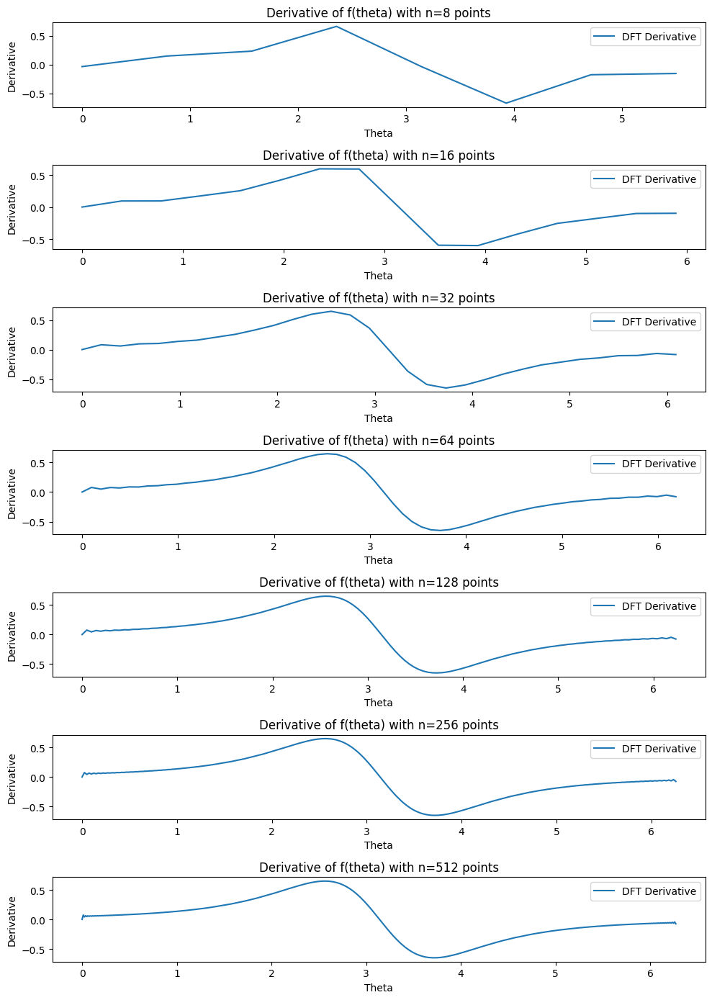

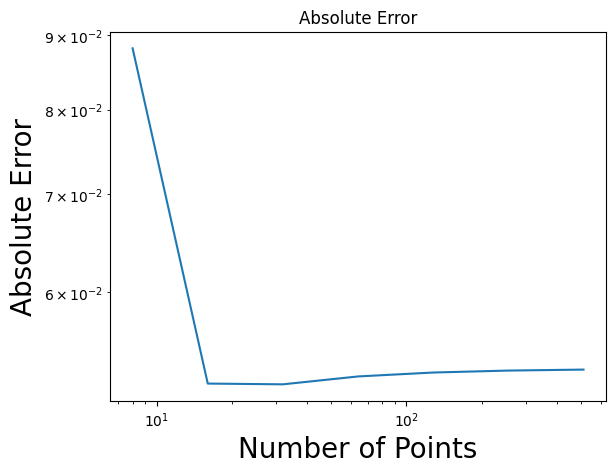

In [19]:
from pylab import *
import math

def get_trig_interpolation_di(dft_results, c, d, t_num=None):
    if t_num is None:
        n = len(dft_results)
    else:
        n = t_num
    a0 = dft_results[0].real / n  # The constant term (DC component)
    an = (dft_results[1:n // 2].real * 2 / n).tolist()  # The cosine coefficients
    bn = (-dft_results[1:n // 2].imag * 2 / n).tolist()  # The sine coefficients

    # Handling the Nyquist frequency term
    if n % 2 == 0:
        an.append(dft_results[n // 2].real / n)
    else:
        an.append(dft_results[n // 2].real * 2 / n)

    # Function to calculate the trigonometric interpolation at a given point t
    def trig_interpolation_function_d(t):
        result = 0
        for k in range(1, n // 2):
            result += -an[k - 1] * np.sin(2 * np.pi * k * t / (d - c)) * (2 * np.pi * k / (d - c))
            result += bn[k - 1] * np.cos(2 * np.pi * k * t / (d - c)) * (2 * np.pi * k / (d - c))
        if n % 2 == 0:
            result += -an[-1] * np.cos(np.pi * (n // 2) * t / (d - c)) * (np.pi * (n // 2) / (d - c))
        return result

    return trig_interpolation_function_d

def calc_f_d(f_values, c, d, theta):
    dft_result = np.fft.rfft(f_values)
    trig_interpolation = get_trig_interpolation_di(dft_result, c, d, len(f_values))
    derivative_values = [trig_interpolation(theta_i) for theta_i in theta]
    return derivative_values

def f(theta):
    return 1/(1+pow((theta - pi),2))

def f_p(theta):
    return -2 * (theta-pi)/pow((pow((theta-pi),2) +1),2)

interval = [2**n for n in range(3,10)]
absolute_errors = []

# ---- another version of visualization ---

# for n in interval:
#     theta = arange(0, 2*pi,2*pi/n)
#     d_theta = 2*pi/n
#     f_values = f(theta)
#     fp_values = f_p(theta)
#     derivative = calc_f_d(f_values, 0, 2 * np.pi, theta)
#     max_error = max(abs(fp_values - derivative))
#     absolute_errors.append(max_error)

    
#     figure()
#     plot(theta, derivative, label='DFT Derivative')
#     title(f'Derivative of f(theta) with n={n} points')
#     xlabel('Theta')
#     ylabel('Derivative')
#     legend()
#     show()


import matplotlib.pyplot as plt

# Assuming 'interval' is a list of values for 'n'
rows = len(interval)  # One row for each plot
fig, axes = plt.subplots(rows, 1, figsize=(10, 2*rows))  # Adjust figsize to make plots wider and shorter

for idx, n in enumerate(interval):
    theta = np.arange(0, 2*np.pi, 2*np.pi/n)
    d_theta = 2*np.pi/n
    f_values = f(theta)  # Make sure 'f' is defined
    fp_values = f_p(theta)  # Make sure 'f_p' is defined
    derivative = calc_f_d(f_values, 0, 2 * np.pi, theta)  # Make sure 'calc_f_d' is defined
    max_error = max(abs(fp_values - derivative))
    absolute_errors.append(max_error)  # Make sure 'absolute_errors' is initialized

    ax = axes[idx] if rows > 1 else axes  # If only one plot, axes is not a list
    ax.plot(theta, derivative, label='DFT Derivative')
    ax.set_title(f'Derivative of f(theta) with n={n} points')
    ax.set_xlabel('Theta')
    ax.set_ylabel('Derivative')
    ax.legend()

plt.tight_layout()  # Adjust subplots to fit in the figure area
plt.show()

plot(interval, absolute_errors)
xlabel("Number of Points", fontsize=20)
ylabel("Absolute Error", fontsize=20)
title("Absolute Error")

yscale('log')   
xscale('log')

## Explanation
I will provide three perspectives to explain why the fourier tranformation for $f(\theta) = \frac{1}{1 + (x - \pi)^2}$ is worse then $g(\theta) = \cos\left(4 \sin\left(\frac{\theta}{2}\right)\right)$.

The main problem is that the derivative of $f(\theta) = \frac{1}{1 + (x - \pi)^2}$ is not not continous under the speical region. Yet for $g(\theta) = \cos\left(4 \sin\left(\frac{\theta}{2}\right)\right)$, any order of derivative is continuous periodic. 

Let's delve deep into what I meant by "the derivative of $f(\theta) = \frac{1}{1 + (x - \pi)^2}$ is not continuous under the special region". We know, of course, that $f$ is not periodic. Yet when we do fourier transform on an interval, e.g. $[0, 2\pi[$, we are seeing $f$ as a periodic function with $T = 2\pi$. This is because we do not care about region other than this interval, yet the fourier transformed intepolation function is periodic. Thus, we can see $f(\theta) = \frac{1}{1 + (x - \pi)^2}$ on $\mathbb{R}$ as duplicate of $f$ on $[0, 2\pi[$. Just, we have $f(\theta) = \frac{1}{1 + (x - \pi)^2}$ on $[0, 2\pi[$, and for any other region we have $f(x + 2\pi) = f(x)$. It is trivial that $f$ is continuous on $\mathbb{R}$ (the only point with speical attention needed is the end point, but we know $f(0) = f(2\pi)$).

Thus, we sort of extended $f$ from  $[0, 2\pi[$ to $\mathbb{R}$ with it being periodic and continuous.

**First Perspective:** We know that for periodic function that only have jump discontinuity (let’s assume only one discontinuity), at this discontinuity, the infinite fourier function series converges to the average of the both end. Which means under the sup norm with the open neighborhood centered at this discontinuity point has a lower bound that is greater than zero. Or the “ossilation measure function” is greater than zeroOur approximation cannot be better than this lower bound in this case. Also, from the property of cosine and sine function (or exponential function), we know after taking the derivative we also have a same kind of fourier series, that is, the series is still of the same kind (all cosine, sine or all expenential). We can see that we have a lower bound that is greater than zero for our derivative approximation, thus the bad intepolation error is expected.

**Second Perspective:** According to, theroem that $f \in C^N$ and periodic, then $c_k = \mathcal{O}\left(\frac{1}{k^N}\right)$ . And we can define a new periodic continuous function $g$ as
$$
g(x) = \sum_{n=-\infty}^{\infty} c_n e^{i2\pi n\frac{x}{L}}.
$$, where we may see different types of convergence (uniformly, pointwise, Abel, Cesaro, etc). Since we know $f$ is differentiable but not $C^1$, thus we can expect the bound $\mathcal{O}\left(\frac{1}{k^N}\right)$ with $N \leq 1$ of convergence, which is a bound with huge possible error

**Third Perspective:** Gibbs phenomenon near points of discontinuity:  This phenomenon is characterized by an overshoot (or undershoot) of the Fourier series approximation near the discontinuities, and this overshoot does not disappear as more terms are added to the series. Instead, the overshoot remains at approximately 9% of the jump discontinuity, regardless of the number of terms in the series.